# Self-Driving Car Engineer Nanodegree

## Project : Advanced Lane Finding

1. Flow of processing  
  1.1 Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.  
  1.2 Apply a distortion correction to raw images.  
  1.3 Use color transforms, gradients, etc., to create a thresholded binary image.  
  1.4 Apply a perspective transform to rectify binary image ("birds-eye view").  
  1.5 Detect lane pixels and fit to find the lane boundary.  
  1.6 Determine the curvature of the lane and vehicle position with respect to center.  
  1.7 Warp the detected lane boundaries back onto the original image.  
  1.8 Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.  

# 1. Flow of processing  
  ## 1.1 Compute the camera calibration matrix and distortion coefficients given a set of chessboard images 

In [2]:
import pickle
import os, glob
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

%matplotlib qt
%matplotlib inline

objpoints.shape :  (17, 54, 3)
imgpoints.shape :  (17, 54, 1, 2)


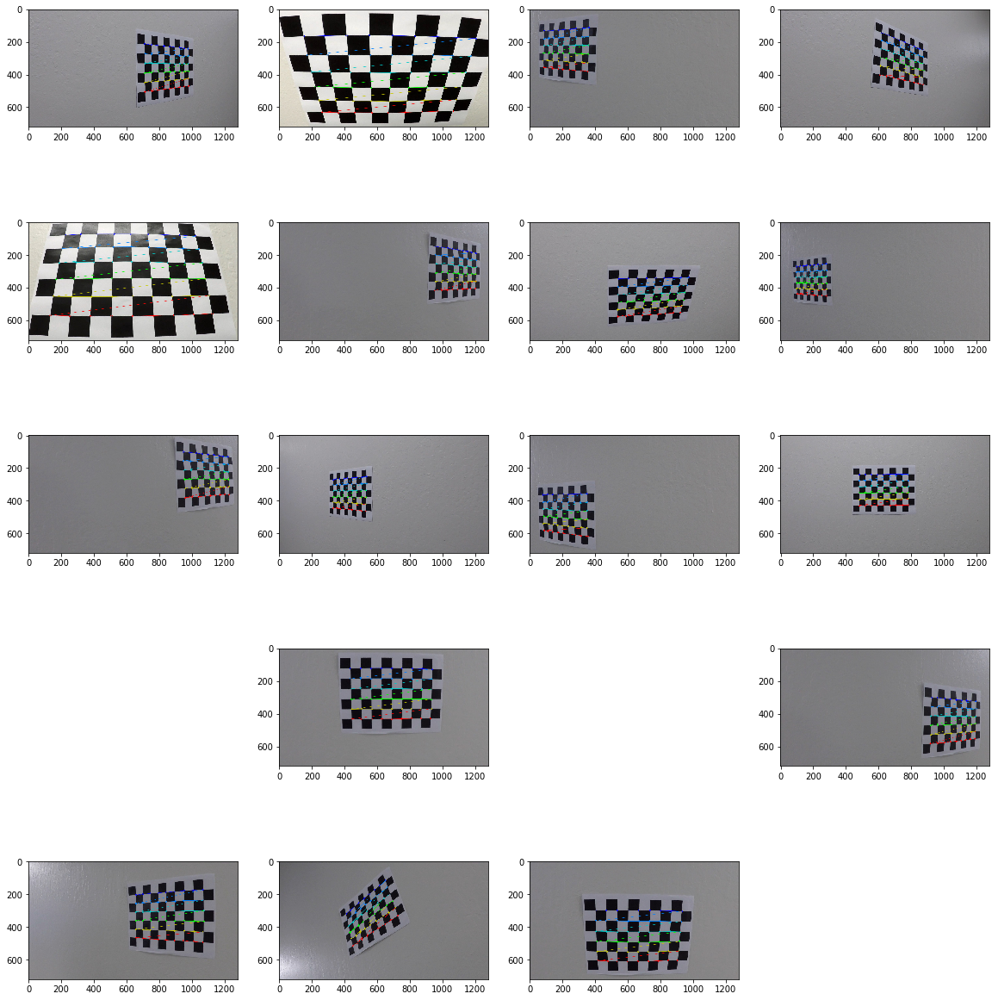

In [3]:
#Arrays to store object points and image points from all the image
objpoints = []
imgpoints = []
nx = 9 
ny = 6
#Prepare object points
objp = np.zeros((ny*nx,3),np.float32)
objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

images = glob.glob('camera_cal/calibration*.jpg')
plt.figure(figsize=(20, 22))

for i, image in enumerate(images):
    #Convert image to grayscale
    img = mpimg.imread(image)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    ret,corners = cv2.findChessboardCorners(gray,(nx,ny),None)

    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp)
        img = cv2.drawChessboardCorners(img, (nx,ny), corners,ret)
        plt.subplot(len(images)//4, 4, i+1)
        plt.imshow(img)
print("objpoints.shape : ", np.array(objpoints).shape)
print("imgpoints.shape : ", np.array(imgpoints).shape)



In [4]:
def layout(original_img, output_img):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    if len(original_img.shape) ==2: 
        cmap1='gray'
    else:
        cmap1=None    
    ax1.imshow(original_img, cmap=cmap1)
    if i==0 : ax1.set_title('Original Image', fontsize=30)
    
    if len(output_img.shape) ==2: 
        cmap2='gray'
    else:
        cmap2=None    
    ax2.imshow(output_img, cmap=cmap2)

    if i==0 : ax2.set_title('Output Image', fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

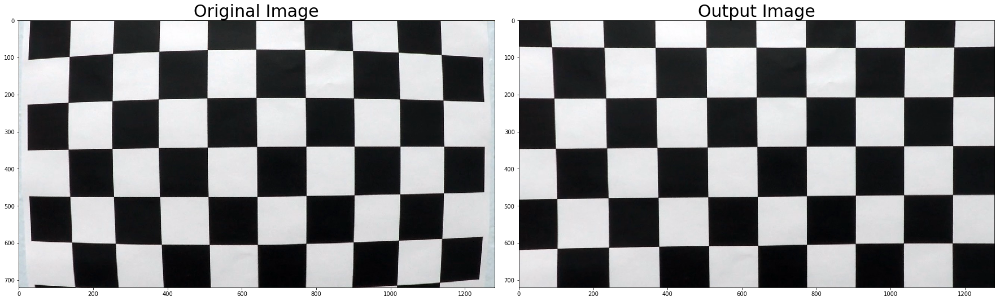

In [5]:
# Read in an image
image = cv2.imread('camera_cal/calibration1.jpg')

def cal_undistort(img, objpoints, imgpoints):
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[1::-1],None,None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist
i=0
plt.show(layout(image,cal_undistort(image, objpoints, imgpoints)))

## 1.2 Apply a distortion correction to raw images.

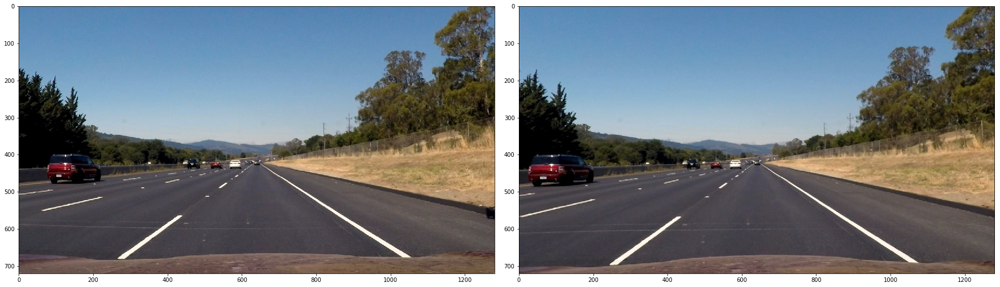

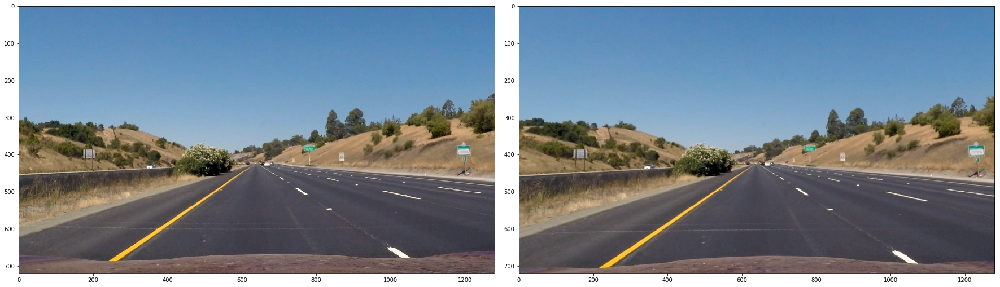

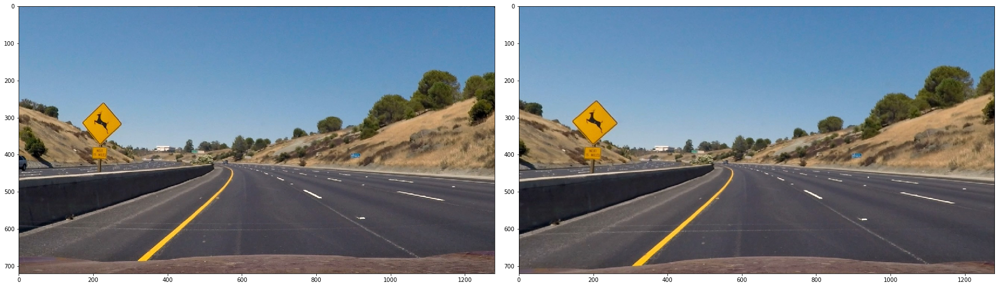

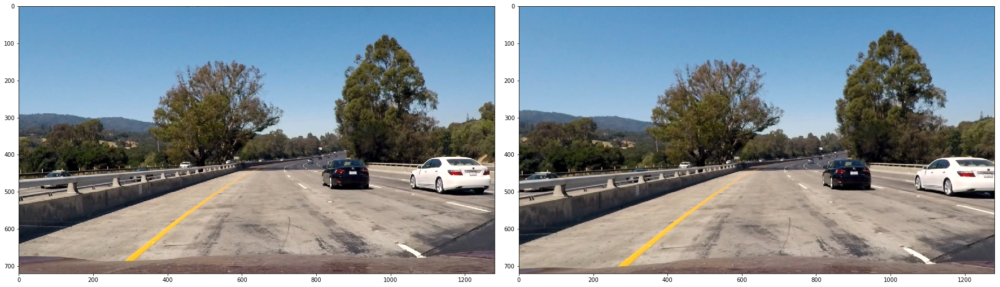

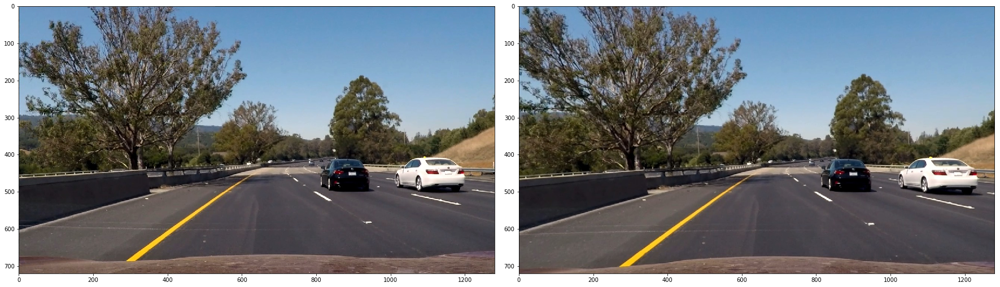

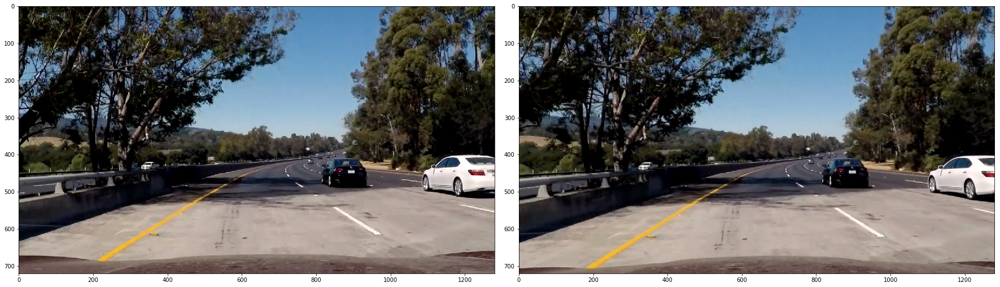

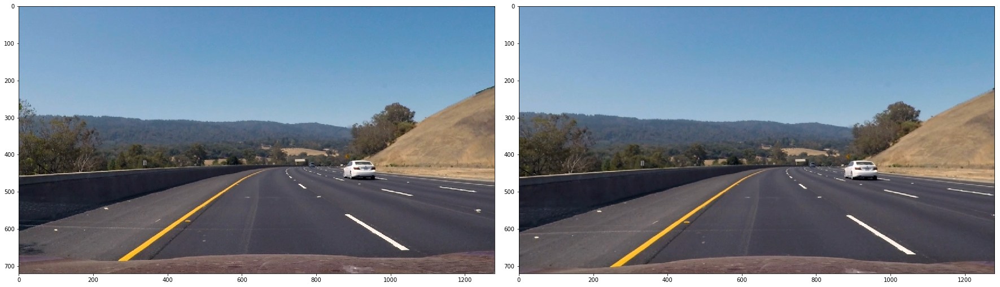

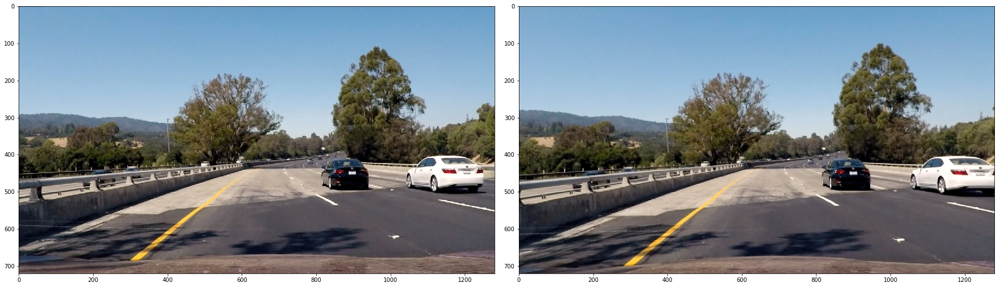

In [6]:
images = glob.glob('test_images/straight_lines*.jpg') + glob.glob('test_images/test*.jpg')
undistorted_array = np.zeros(np.append(0, mpimg.imread(images[0]).shape)) 
for i, image in enumerate(images):
    img = mpimg.imread(image)
    undistorted = cal_undistort(img, objpoints, imgpoints)
    undistorted_array = np.append(undistorted_array, np.expand_dims(undistorted,axis=0), axis=0).astype(np.uint8)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)  
    ax2.imshow(undistorted)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## 1.3 Use color transforms, gradients, etc., to create a thresholded binary image.

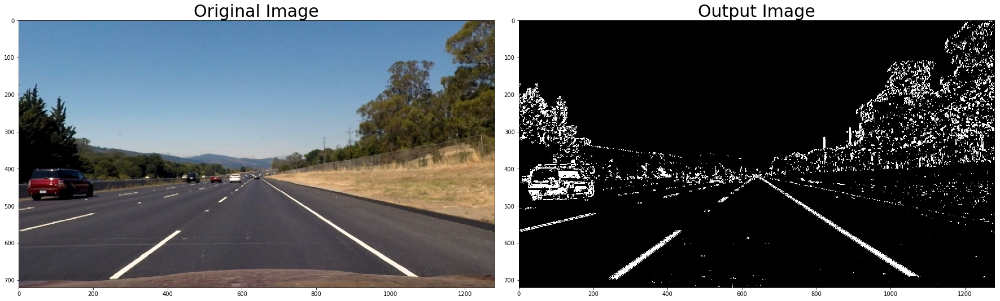

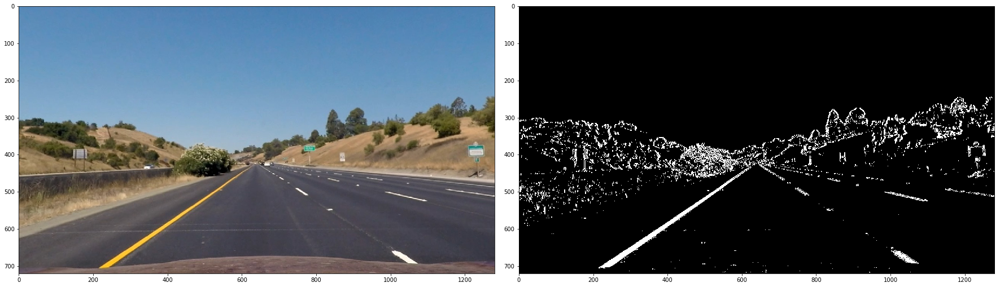

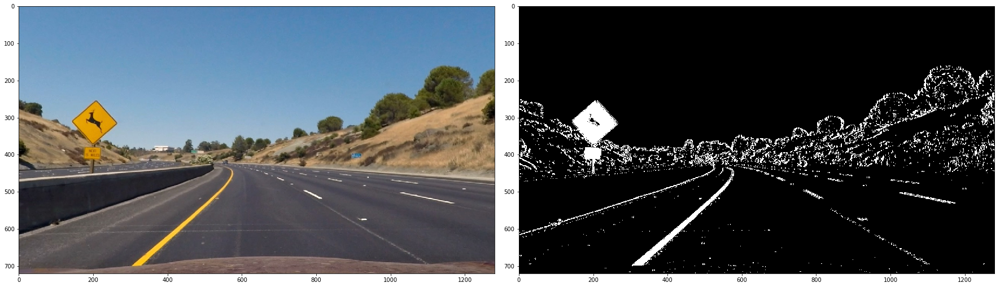

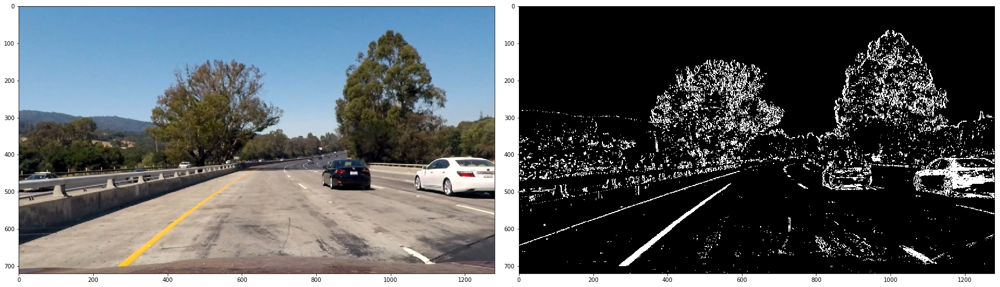

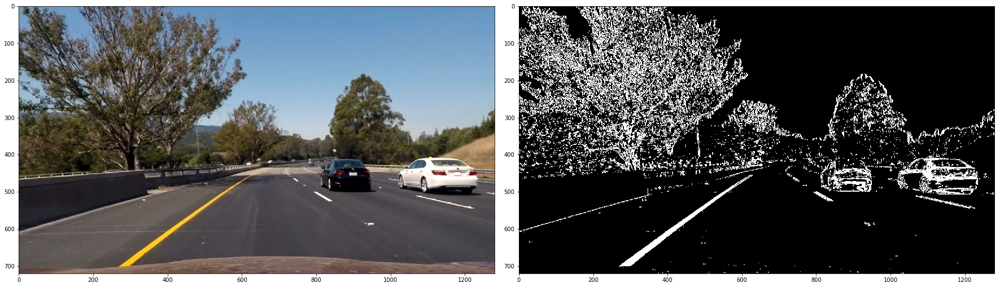

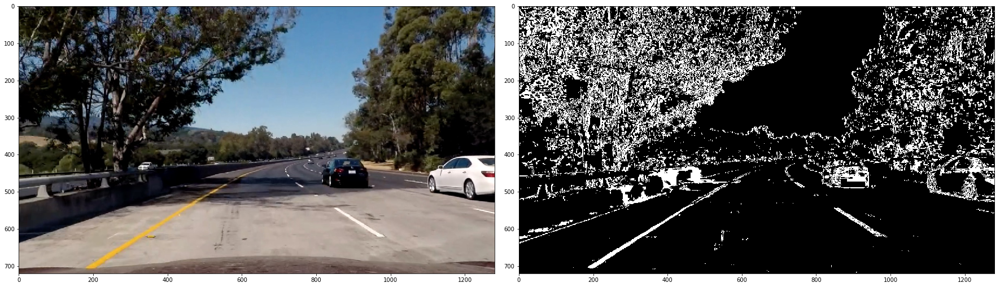

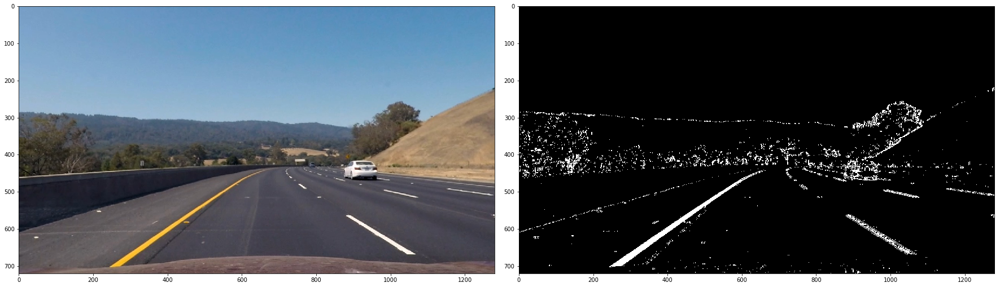

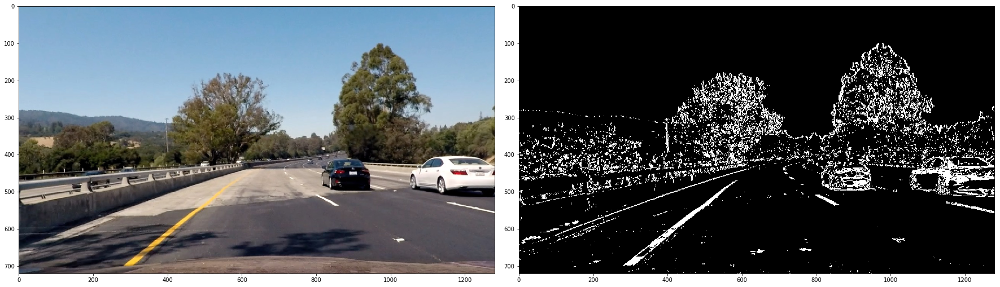

In [7]:
# Combined S channnel and gradient thresholds
def cal_convert(img, s_thresh=(170, 255), sx_thresh=(20, 100)):
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # Stack each channel
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
    
    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1
    return combined_binary

combined_binary_array = np.zeros([0, undistorted_array[0].shape[0], undistorted_array[0].shape[1]]) 
for i, undistorted in enumerate(undistorted_array):
    combined_binary= cal_convert(undistorted)
    combined_binary_array = np.append(combined_binary_array, np.expand_dims(combined_binary,axis=0), axis=0).astype(np.uint8)
    plt.show(layout(undistorted, combined_binary))

## 1.4 Apply a perspective transform to rectify binary image ("birds-eye view").

In [8]:
image = cv2.imread('test_images/straight_lines1.jpg')
src=np.float32([[150,720],[590,450],[700,450],[1250,720]]) 
dst= np.float32([[200 ,720], [200  ,0], [980 ,0], [980 ,720]])

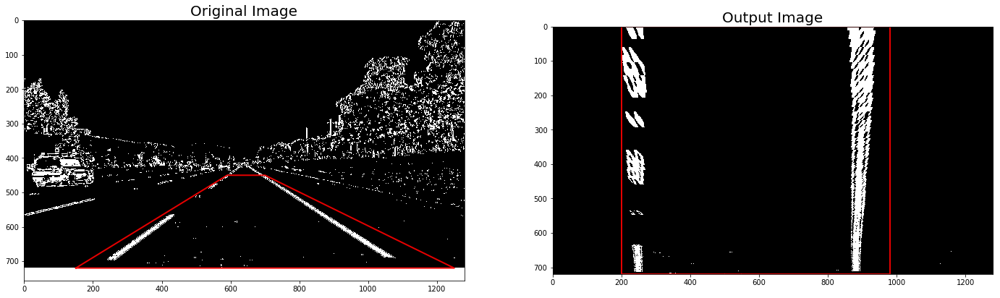

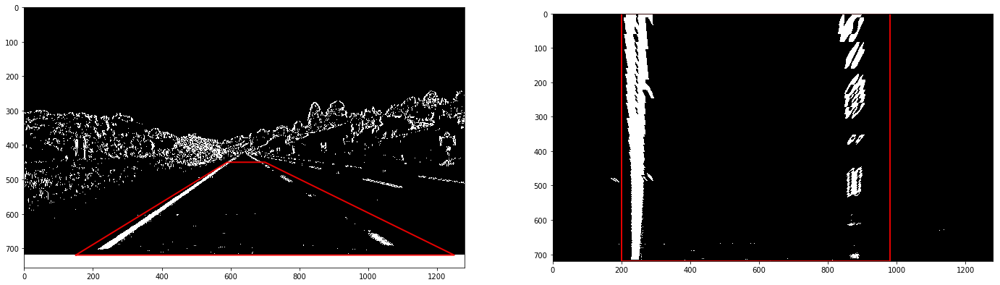

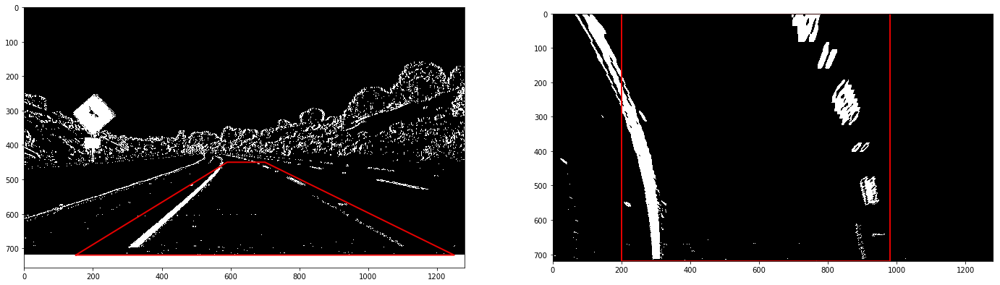

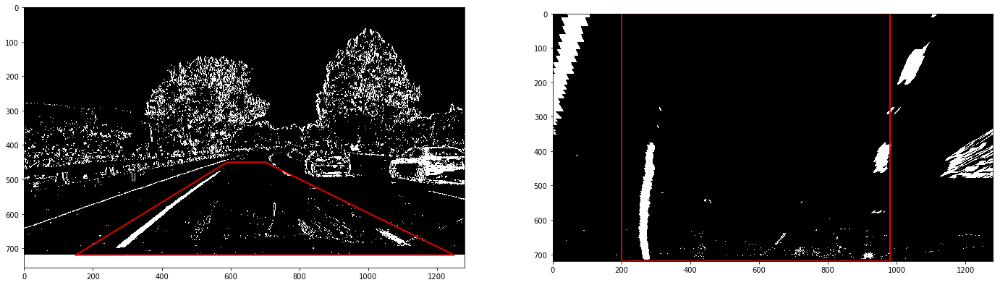

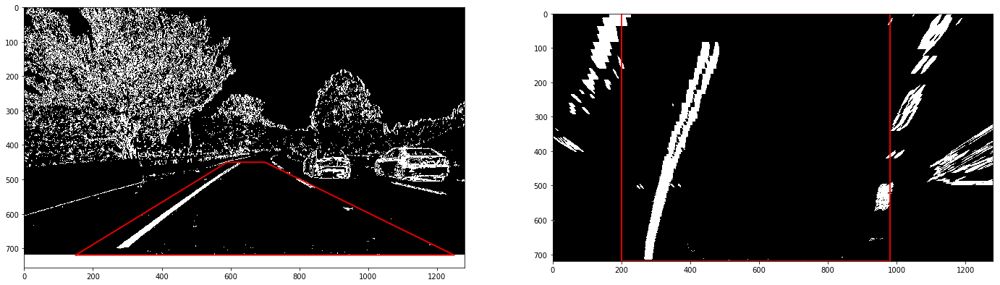

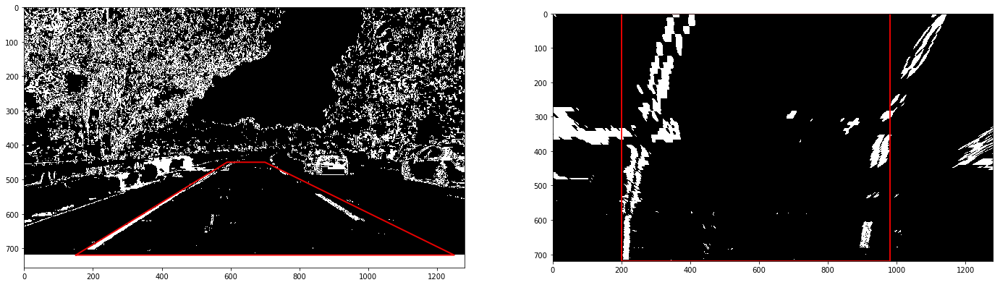

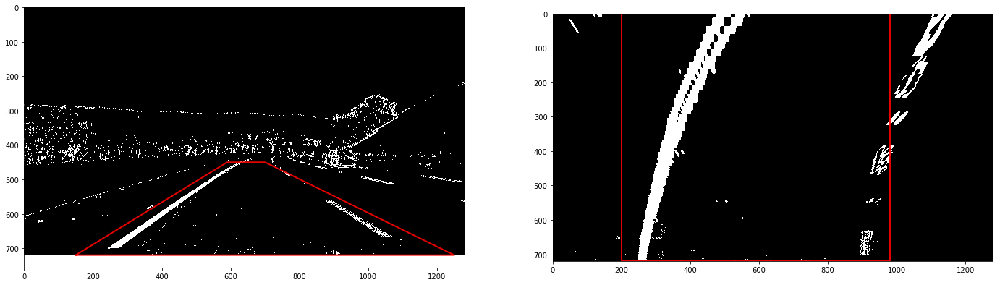

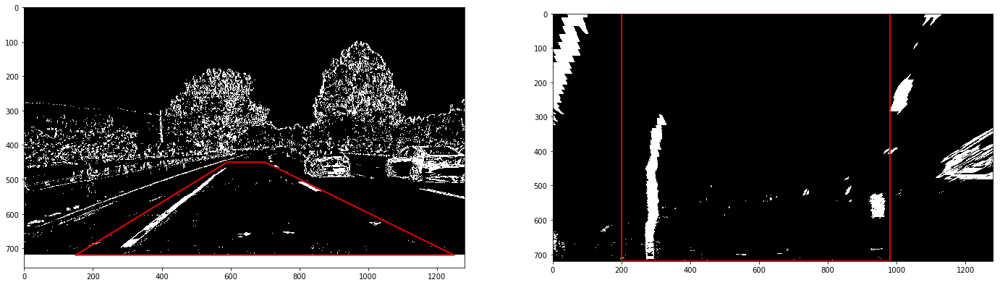

In [9]:
def cal_warp(img):
    img_size = img.shape[1],img.shape[0]  
    # d) use cv2.getPerspectiveTransform() to get M, the transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    # e) use cv2.warpPerspective() to warp your image to a top-down view
    warped = cv2.warpPerspective(img, M, img_size, flags= cv2.INTER_LINEAR)
    return warped

# For draw red line with below points
src_x = [src[0][0], src[1][0], src[2][0], src[3][0], src[0][0]]
src_y = [src[0][1], src[1][1], src[2][1], src[3][1], src[0][1]]
dst_x = [dst[0][0], dst[1][0], dst[2][0], dst[3][0], dst[0][0]]
dst_y = [dst[0][1], dst[1][1], dst[2][1], dst[3][1], dst[0][1]]

warped_array = np.zeros_like(combined_binary_array) # (8, 720, 1280)
for i, combined_binary in enumerate(combined_binary_array):
    # Warp the undistorted image (birds-eye view)
    warped = cal_warp(combined_binary)
    warped_array[i] = np.expand_dims(warped, axis=0).astype(np.uint8)
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24,9))
    ax1.imshow(combined_binary, cmap='gray')
    ax1.plot(src_x, src_y, color='red', alpha=0.9, linewidth=2, solid_capstyle='round', zorder=2)
    if i==0 : ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(warped, cmap='gray')
    ax2.plot(dst_x, dst_y, color='red', alpha=0.9, linewidth=2, solid_capstyle='round', zorder=2)
    ax2.set_ylim([warped.shape[0], 0])
    if i==0 : ax2.set_title('Output Image', fontsize=20)

## 1.5 Detect lane pixels and fit to find the lane boundary.
### 1.5.1   Find lane position with histogram  
To detect the pixels that correspond to the lane lines the histogram is used as as a basis. The peaks in an histogram of the binary image in birds view represent the position of the lanes, as is shown in the following example.

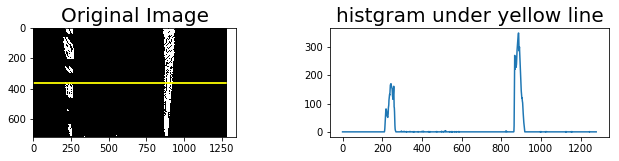

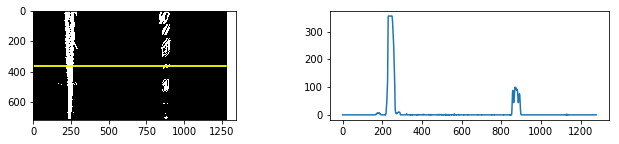

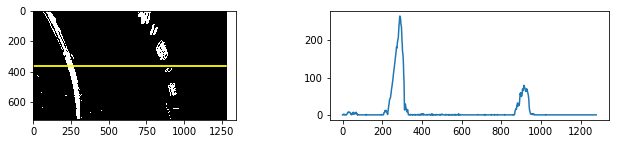

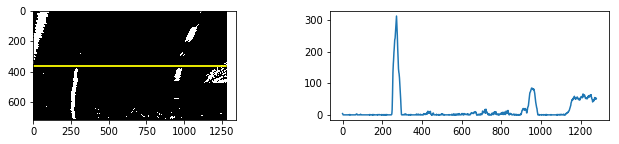

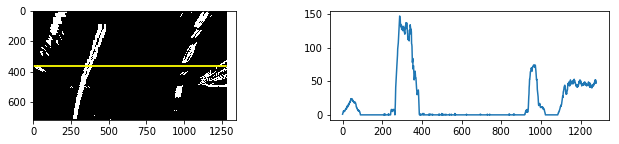

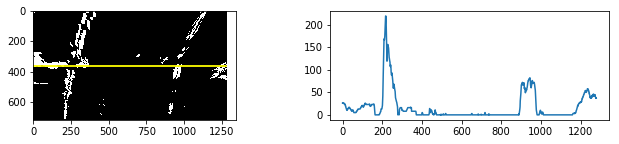

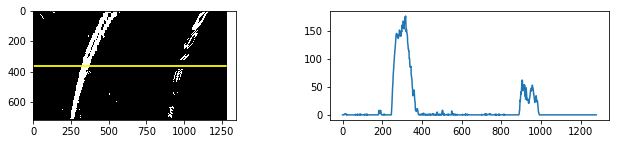

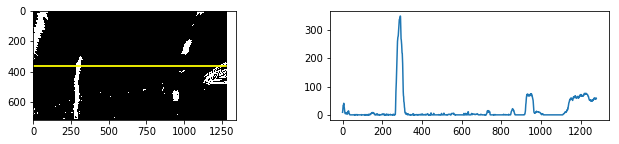

In [10]:
def hist(img):
    # Lane lines are likely to be mostly vertical nearest to the car
    y_criteria = img.shape[0]//2
    bottom_half = img[y_criteria:,:]
    # i.e. the highest areas of vertical lines should be larger values
    histogram = np.sum(bottom_half ,axis=0)    
    return histogram, y_criteria
    
for i, warped in enumerate(warped_array):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(11,2))
    histgram, y_criteria = hist(warped)
    ax1.imshow(warped, cmap='gray')
    ax1.plot([0,warped.shape[1]], [y_criteria,y_criteria], color='yellow', alpha=0.9, linewidth=2, solid_capstyle='round', zorder=2)
    
    if i==0 : ax1.set_title('Original Image', fontsize=20)
    ax2.plot(histgram)
    if i==0 : ax2.set_title('histgram under yellow line', fontsize=20)

### 1.5.2 Sliding Window Search   
* The left and right base points are calculated from the histogram
* We then calculate the position of all non zero x and non zero y pixels.
* We then Start iterating over the windows where we start from points calculate in point 1.
* We then identify the non zero pixels in the window we just defined
* We then collect all the indices in the list and decide the center of next window using these points
* Once we are done, we seperate the points to left and right positions
* We then fit a second degree polynomial using np.polyfit and point calculate .

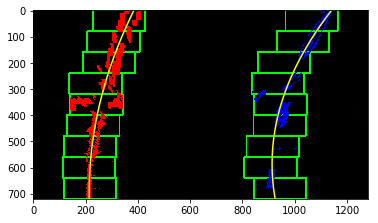

In [11]:
def find_sliding_window(binary_warped):
    global Easy_search
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    # HYPERPARAMETERS # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        ### TO-DO: Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - margin  # Update this
        win_xleft_high = leftx_current + margin  # Update this
        win_xright_low = rightx_current - margin  # Update this
        win_xright_high = rightx_current + margin # Update this
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 5) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 5) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
            
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
        ### (`right` or `leftx_current`) on their mean position ###
        pass # Remove this when you add your function

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        Easy_search = True
        
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]    
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
#    Easy_search = True
    
    return left_fit, right_fit, leftx, lefty, rightx, righty, out_img #, Easy_search

def draw_sliding_window(binary_warped, left_fit, right_fit, leftx, lefty, rightx, righty, out_img):

    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = None
        right_fitx = None

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]
#    plt.figure(figsize=(15,7))
 
    return out_img

#---------------------Test the image----------------------------------------------------------------#
i=5
left_fit, right_fit, leftx, lefty, rightx, righty, out_img = find_sliding_window(warped_array[i])
out_img2 = draw_sliding_window(out_img, left_fit, right_fit, leftx, lefty, rightx, righty, out_img)
ploty = np.linspace(0, out_img.shape[0]-1, out_img.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.imshow(out_img2, cmap='gray')       

### 1.5.3 previous lines area search
The previous function implements the lane lines detection using an sliding window approach.  
However, once we have the estimation of both lane lines for a given frame, it is possible to exploit the fact that the estimation is similar between consecutive frames. This enables the implementation of a more effecient lane estimation approach, which focuses of a narrow area around the lane lines detected in previous frames to avoid performing the sliding window approach for every frame from scratch

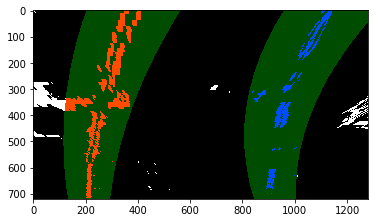

In [12]:
def search_around_poly(binary_warped,left_fit, right_fit):
    global Easy_search    
    global avg_left_fit
    global avg_right_fit
    
    # HYPERPARAMETER
    margin =100    
    minpix = 1500       
    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    margin2 = np.array(nonzero[0])
    margin2 = (np.max(nonzeroy) - nonzeroy)/np.max(nonzeroy)*margin+80 

    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin2)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin2)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin2)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin2)))
            
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit new polynomials
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
 
    margin3 = np.array(nonzero[0])
    margin3 = (np.max(ploty) - ploty)/np.max(ploty)*margin+80  

    if len(leftx) < 3*len(rightx) or 3*len(leftx) < len(rightx) :
        Easy_search = False    
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = None
        right_fitx = None
        left_fit = 0
        right_fit = 0
        Easy_search = False
        
    if len(leftx) < minpix or len(rightx) < minpix :
        left_fit = avg_left_fit
        right_fit = avg_right_fit
        Easy_search = False
        
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin3, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin3, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin3, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin3, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)    
    ## End visualization steps ##   
#    print(len(leftx),len(lefty),len(rightx), len(righty))
    return left_fit, right_fit, leftx, lefty, rightx, righty,result

#---------------------Test the image----------------------------------------------------------------#
i=5
left_fit, right_fit, leftx, lefty, rightx, righty, out_img = find_sliding_window(warped_array[i])
left_fit, right_fit, leftx, lefty, rightx, righty,out_img22 = search_around_poly(warped_array[i], left_fit, right_fit)      
plt.imshow(out_img22, cmap='gray')


## 1.6 Determine the curvature of the lane and vehicle position with respect to center.

In [13]:
def measure_Curvature_and_CentorPosition(binary_warped,left_fit, right_fit):

    # -----------------calculate curvature-------------------------------
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    ### TO-DO: Fit a second order polynomial to each using `np.polyfit` ###
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    leftx = left_fit[0]*ploty**2 + left_fit[1]*ploty +left_fit[2]
    rightx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    left_fit_cr = np.polyfit(ploty *ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty *ym_per_pix, rightx*xm_per_pix, 2)

    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)   
    # Calculation of R_curve (radius of curvature)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    # -----------------calculate Vehicle Centor offset ------------------------------- 
    left_x_eval = left_fit[0]*y_eval**2 + left_fit[1]*y_eval + left_fit[2]
    right_x_eval = right_fit[0]*y_eval**2 + right_fit[1]*y_eval + right_fit[2]
    lane_ctr = (left_x_eval + right_x_eval)/2
    vehicle_ctr = (binary_warped.shape[1])/2 
    offset = (lane_ctr - vehicle_ctr) * xm_per_pix
    avg_curvrad = (left_curverad + right_curverad)/2
    return avg_curvrad,left_curverad,right_curverad, offset

for i, warped in enumerate(warped_array):
    left_fit, right_fit, leftx, lefty, rightx, righty, out_img = find_sliding_window(warped)
    curverad,_,_, offset = measure_Curvature_and_CentorPosition(warped,left_fit, right_fit)
    print('curverad', curverad, 'm', '   offset', offset, 'm')

curverad 30750.7453321 m    offset -0.414994651803 m
curverad 32202.8850459 m    offset -0.449626368607 m
curverad 368.428448333 m    offset -0.168593484618 m
curverad 435.138469833 m    offset -0.243793170614 m
curverad 995.970245286 m    offset -0.234367719642 m
curverad 355.363598184 m    offset -0.371662185829 m
curverad 509.323434143 m    offset -0.296891646546 m
curverad 490.227411947 m    offset 1.44148313185 m


## 1.7 Warp the detected lane boundaries back onto the original image.

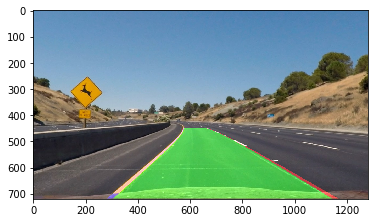

In [14]:
def add_green(original_img, binary_warped, left_fit, right_fit):
    
    #Draw Green zone with ploty elements
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty +left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2] 
    
    left_pipe = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    right_pipe = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    green_zone = np.hstack((left_pipe, right_pipe))
    
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    cv2.fillPoly(color_warp, np.int_([green_zone]), (0,255, 0))
    cv2.polylines(color_warp, np.int32([left_pipe]), isClosed=False, color=(0,0,255), thickness=15)
    cv2.polylines(color_warp, np.int32([right_pipe]), isClosed=False, color=(255,0,0), thickness=15)

    Minv = cv2.getPerspectiveTransform(dst, src) #Reverse the "srd, dst"
    re_warped = cv2.warpPerspective(color_warp, Minv, (binary_warped.shape[1], binary_warped.shape[0]))#, flags= cv2.INTER_LINEAR)    
    add_green_img = cv2.addWeighted(original_img, 1, re_warped, 0.5, 0)

    return add_green_img

#---------------------Test the image----------------------------------------------------------------#
i=2
undistorted = undistorted_array[i]
sliding_return = find_sliding_window(warped_array[i])
left_fit = sliding_return[0]
right_fit = sliding_return[1]
result = add_green(undistorted , warped_array[i], left_fit, right_fit)

plt.imshow(result)

## 1.8 Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

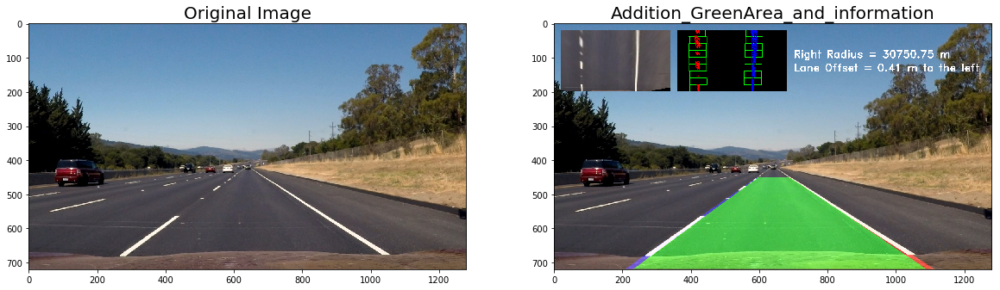

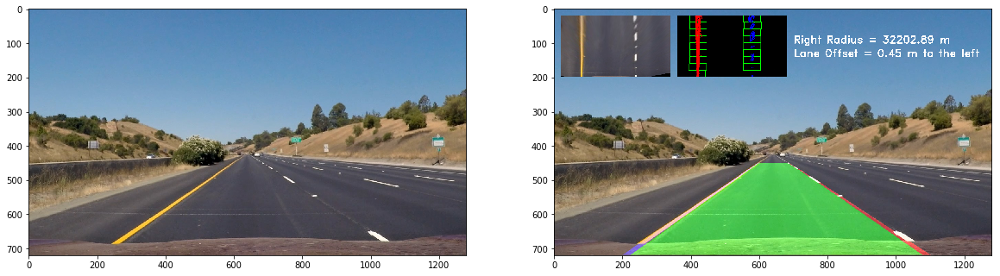

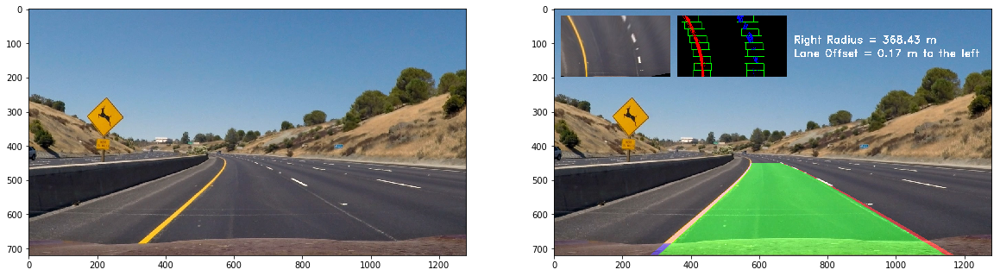

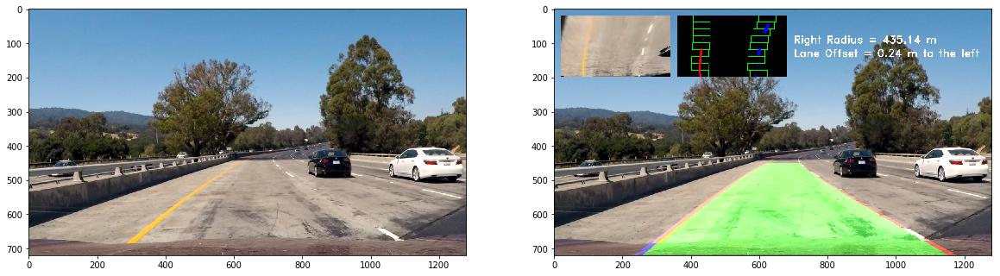

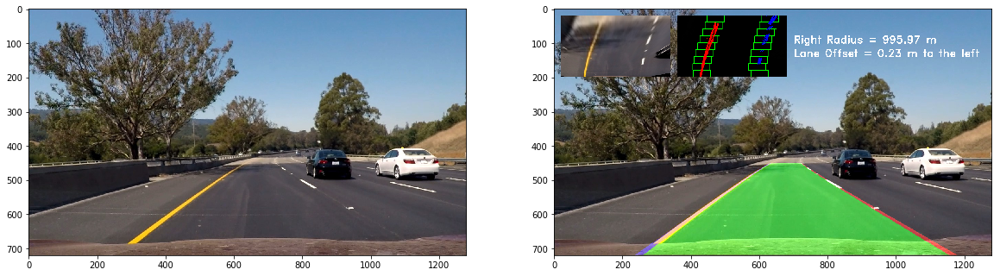

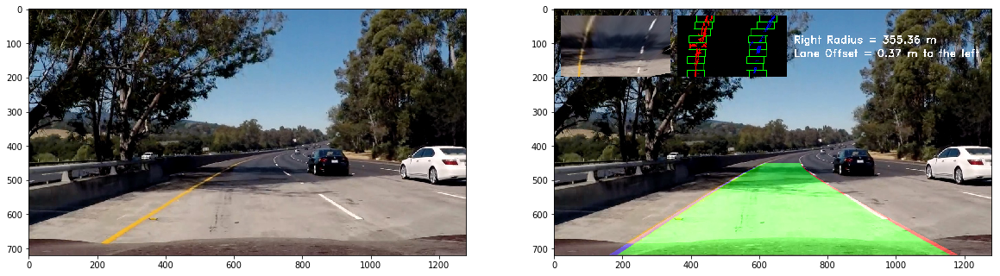

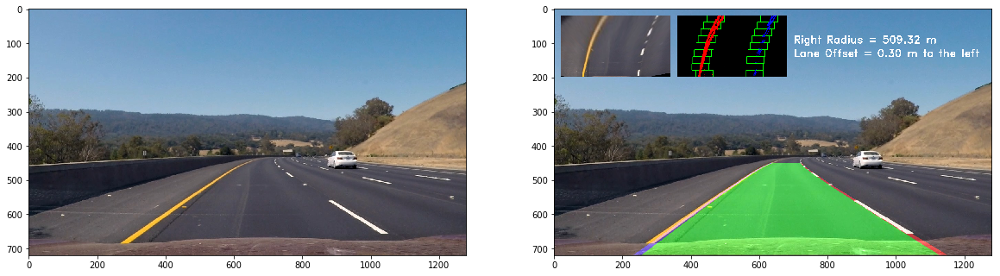

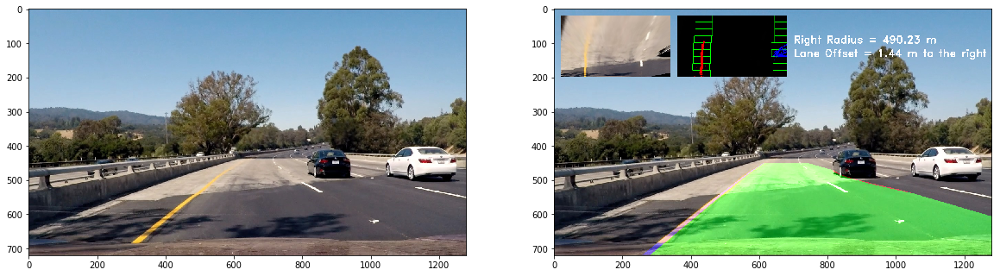

In [15]:
def Add_information(add_green_img, colored_binary_img, color_lane_warped, curverad, offset):

    # For parametor to add a small window 
    width = add_green_img.shape[1]
    height = add_green_img.shape[0]
    picture_ratio = 0.25
    picture_h, picture_w = int(picture_ratio * height), int(picture_ratio * width)
    off = 20
    
    # Add a small window of the birds eye view (collor lane)
    small_warped_input = cv2.resize(color_lane_warped, dsize=(picture_w, picture_h))
    add_green_img[off:picture_h+off, off:off+picture_w, :] = small_warped_input
    
    # Add a small window of the birds eye view (binary combined lane)
    small_warped_lane = cv2.resize(colored_binary_img, dsize=(picture_w, picture_h))
    add_green_img[off:picture_h+off, 2*off+picture_w:2*(off+picture_w), :] = small_warped_lane
    
    # Add text with the curvature and lane offset information

    radius_text = "Right Radius = {:.2f} m".format(curverad)
    cv2.putText(add_green_img, radius_text, (3*off+2*picture_w, 5*off),2, 1, (255,255,255), 2)
    lane_offset_text = "Lane Offset = {:.2f} m".format(abs(offset))
    if offset < 0:
        lane_offset_text += " to the left"
    else:
        lane_offset_text += " to the right"
    cv2.putText(add_green_img, lane_offset_text, (3*off+2*picture_w, 7*off),2, 1, (255,255,255), 2)
    
    return add_green_img

#---------------------Test the image----------------------------------------------------------------#
for i, image in enumerate(images):
    
    img = mpimg.imread(image)
    undistorted = cal_undistort(img, objpoints, imgpoints)
    combined_binary= cal_convert(undistorted)
    warped = cal_warp(combined_binary)
    
    left_fit, right_fit, leftx, lefty, rightx, righty, out_img1 = find_sliding_window(warped)
    colored_binary_img = draw_sliding_window(warped, left_fit, right_fit, leftx, lefty, rightx, righty, out_img1)
    add_green_img = add_green(img, warped, left_fit, right_fit)
    
    color_lane_undistorted = cal_undistort(img, objpoints, imgpoints)
    color_lane_warped = cal_warp(color_lane_undistorted)
    curverad,_,_, offset = measure_Curvature_and_CentorPosition(warped,left_fit, right_fit)
    
    result = Add_information(add_green_img, colored_binary_img, color_lane_warped, curverad, offset)
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    if i==0 : ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(result)
    if i==0 : ax2.set_title('Addition_GreenArea_and_information', fontsize=20)

In [16]:
def cal_lane_distance(binary_warped, left_fit, right_fit):
    
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty +left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2] 
    
    Lane_width = right_fitx - left_fitx
    max_Lane_widtht = np.max(Lane_width)
    min_Lane_widtht = np.min(Lane_width)
    Lane_distance = max_Lane_widtht - min_Lane_widtht
    avg_Lane_width = np.mean(Lane_width)
    
    return Lane_distance ,avg_Lane_width

print(cal_lane_distance(warped, left_fit, right_fit))

(1006.9694574219284, 1161.2470724692678)


In [17]:
N = 35 # flame number for calculate average
List_left_fit=[]
List_right_fit=[]
previous_lane_distance=[]
avg_left_fit =[]
avg_right_fit =[]
Easy_search = False
    
def make_movie(img):

    global List_left_fit
    global List_right_fit
    global avg_left_fit
    global avg_right_fit
    global Easy_search
    
    undistorted = cal_undistort(img, objpoints, imgpoints)    
    color_lane_warped = cal_warp(undistorted)
    warped_binary= cal_convert(color_lane_warped)  
   
    #Switching for searchig code
    if Easy_search is False: #Use Sliding_window_searching
        left_fit, right_fit, leftx, lefty, rightx, righty, out_img = find_sliding_window(warped_binary)
         
        if len(List_left_fit)>1 : # To avoid the first one frame error            
            lane_distance, Lane_width = cal_lane_distance(warped_binary, left_fit, right_fit)
            previous_lane_distance, pvs_avg_Lane_width = cal_lane_distance(warped_binary, avg_left_fit, avg_right_fit)
            
            #Use the previous line if the line distance change rate is 5 times or more
            if lane_distance > 5*previous_lane_distance :
                left_fit = avg_left_fit 
                right_fit = avg_right_fit
            #Use the previous line if the line width change rate is 0.8 times or more    
            if Lane_width < 0.7*pvs_avg_Lane_width or Lane_width is 0:
                left_fit = avg_left_fit 
                right_fit = avg_right_fit
           
        colored_binary_img = draw_sliding_window(warped_binary, left_fit, right_fit, leftx, lefty, rightx, righty, out_img) 
        Easy_search = True 
        
    else: #Use previous polynomials area _searching
        left_fit = List_left_fit[-1] 
        right_fit = List_right_fit[-1] 
        left_fit, right_fit, leftx, lefty, rightx, righty, colored_binary_img = search_around_poly(warped_binary,left_fit, right_fit)
         
        if len(List_left_fit)>1 : # To avoid the first one frame error 
            lane_distance, Lane_width = cal_lane_distance(warped_binary, left_fit, right_fit)
            previous_lane_distance, pvs_avg_Lane_width = cal_lane_distance(warped_binary, avg_left_fit, avg_right_fit)
            
            #Use the previous line if the line distance change rate is 5 times or more
            if lane_distance > 10*previous_lane_distance : #Use the previous line if the line width change rate is 5 times or more
                left_fit = (left_fit + List_left_fit[-1])/2 
                right_fit = (right_fit + List_right_fit[-1])/2
                Easy_search = False
            #Use the previous line if the line width change rate is 0.8 times or more    
            if Lane_width < 0.5*pvs_avg_Lane_width or Lane_width is 0 :
                left_fit = List_left_fit[-1]
                right_fit = List_right_fit[-1]
                Easy_search = False
                
        if  left_fit is 0 or  right_fit is 0 :
            lane_distance, Lane_width = cal_lane_distance(warped_binary, left_fit, right_fit)
            previous_lane_distance, pvs_avg_Lane_width = cal_lane_distance(warped_binary, avg_left_fit, avg_right_fit)
            colored_binary_img = draw_sliding_window(warped_binary, left_fit, right_fit, leftx, lefty, rightx, righty, out_img)
            Easy_search = False
            
    if len(List_left_fit)>1 : # To avoid the first one frame error                  
        _,L_curverad, R_curverad, offset = measure_Curvature_and_CentorPosition(warped_binary,left_fit, right_fit) 
        _,prv_L_curverad, prv_R_curverad, prv_offset = measure_Curvature_and_CentorPosition(warped_binary, List_left_fit[-1], List_right_fit[-1])
        
        differential_L = abs(L_curverad - prv_L_curverad)/abs(prv_L_curverad)
        differential_R = abs(R_curverad - prv_R_curverad)/abs(prv_R_curverad)
        
        #Eliminate irregular curvatures by changing the curvature of the left and right curves
        if abs(differential_L+differential_R)/(2*differential_R) >2.5 and differential_L > 1.5: 
            left_fit = List_left_fit[-1]
        if abs(differential_R+differential_L)/(2*differential_L) >2.5 and differential_R > 1.5:
            right_fit = List_right_fit[-1]
        if abs(offset - prv_offset) > 0.3: #Use the previous line if the offset change rate is 0.3 times or more 
            left_fit = List_left_fit[-1]
            right_fit = List_right_fit[-1]
        
    if len(List_left_fit) < N or len(List_right_fit) < N :
        List_left_fit.append(left_fit)
        List_right_fit.append(right_fit)   
    else:
        List_left_fit.append(left_fit)
        List_right_fit.append(right_fit)
        List_left_fit.pop(0)        
        List_right_fit.pop(0)
           
    avg_left_fit = np.mean((List_left_fit),axis=0) *0.5 + left_fit*0.5
    avg_right_fit = np.mean((List_right_fit),axis=0) *0.5 + right_fit*0.5

    curverad,left_curverad,right_curverad, offset = measure_Curvature_and_CentorPosition(warped_binary,avg_left_fit, avg_right_fit)   
    add_green_img = add_green(img, warped_binary, avg_left_fit, avg_right_fit)
    
    result = Add_information(add_green_img, colored_binary_img, color_lane_warped, curverad, offset)

    return result

In [73]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [81]:
List_left_fit=[]
List_right_fit=[]
Easy_search = False
project_output = 'output_videos/project_output.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
#clip1 = VideoFileClip("project_video.mp4").subclip(8,15)
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(make_movie) #NOTE: this function expects color images!!
%time white_clip.write_videofile(project_output, audio=False)

[MoviePy] >>>> Building video output_videos/project_output.mp4
[MoviePy] Writing video output_videos/project_output.mp4



100%|█████████▉| 1260/1261 [26:53<00:01,  1.27s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_videos/project_output.mp4 

CPU times: user 24min 26s, sys: 1.22 s, total: 24min 27s
Wall time: 26min 56s


In [82]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML
# Global left and right lane lines objects
List_left_fit=[]
List_right_fit=[]
Easy_search = False
challenge_output = 'output_videos/challenge_output.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
#clip1 = VideoFileClip("challenge_video.mp4").subclip(3,4)
clip1 = VideoFileClip("challenge_video.mp4")
white_clip = clip1.fl_image(make_movie) #NOTE: this function expects color images!!
%time white_clip.write_videofile(challenge_output, audio=False)

[MoviePy] >>>> Building video output_videos/challenge_output.mp4
[MoviePy] Writing video output_videos/challenge_output.mp4



100%|██████████| 485/485 [10:15<00:00,  1.26s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_videos/challenge_output.mp4 

CPU times: user 9min 22s, sys: 772 ms, total: 9min 23s
Wall time: 10min 18s


In [79]:
# Global left and right lane lines objects
List_left_fit=[]
List_right_fit=[]
Easy_search = False
harder_challenge_output = 'output_videos/harder_challenge_output.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
#clip1 = VideoFileClip("harder_challenge_video.mp4").subclip(1,2)
clip1 = VideoFileClip("harder_challenge_video.mp4")
white_clip = clip1.fl_image(make_movie) #NOTE: this function expects color images!!
%time white_clip.write_videofile(harder_challenge_output, audio=False)

[MoviePy] >>>> Building video output_videos/harder_challenge_output.mp4
[MoviePy] Writing video output_videos/harder_challenge_output.mp4



100%|█████████▉| 1199/1200 [26:33<00:01,  1.29s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_videos/harder_challenge_output.mp4 

CPU times: user 23min 25s, sys: 1.41 s, total: 23min 26s
Wall time: 26min 37s
